# Homework Assignment 1
### [The Art of Analyzing Big Data - The Data Scientist’s Toolbox](https://www.ise.bgu.ac.il/labs/fire/lectures.html)
#### By Dr. Michael Fire 

For this homework you will need to write code that analyzes real-world datasets. The code needs to be written in Python using the [sqlite3](https://docs.python.org/2/library/sqlite3.html) package. 

**Please note:** You need to answer only the questions that match your ID first digit.

# 1. Babies Names Dataset (35pt)

**Task 1 (for everyone):** Write a code that uses the  [**babies names dataset** ](https://www.kaggle.com/kaggle/us-baby-names?select=NationalNames.csv) (use NationalNames.csv) and creates a table named (Names) with the dataset data and the following columns: 'State', 'Gender', 'Name', 'Count' , and 'Year' (5pt)
**Bonus:** Load the data using a Batch INSERT SQL Query (2pt)

In [1]:
!mkdir /root/.kaggle/

In [4]:
!pip install pony

     |████████████████████████████████| 296kB 5.5MB/s 
  Created wheel for pony: filename=pony-0.7.14-cp37-none-any.whl size=351277 sha256=0cdb7b36cdef6581b423b28238e0a986336cadc3c8240de5b865b782a08c75fe
  Stored in directory: /root/.cache/pip/wheels/ef/70/ba/dc705f1c2bdb39f3d9802895fbc96074a12de6591dedc22289
Successfully built pony


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
import json
import os
import sqlite3
from pony.orm import *
import pandas as pd
from psycopg2.extras import execute_values
import matplotlib.pyplot as plt

/usr/local/lib/python3.7/dist-packages/psycopg2/__init__.py:144: UserWarning: The psycopg2 wheel package will be renamed from release 2.8; in order to keep installing from binary please use "pip install psycopg2-binary" instead. For details see: <http://initd.org/psycopg/docs/install.html#binary-install-from-pypi>.
  """)


In [6]:
api_token = {"username":"pelegbiton","key":"051ef411347988f9d3cb1cd741140667"}
with open('/root/.kaggle/kaggle.json', 'w') as file:
  json.dump(api_token, file)
!chmod 600 /root/.kaggle/kaggle.json

In [7]:
# Creating a dataset directory
!mkdir ./datasets
!mkdir ./datasets/us-baby-name

# download the dataset from Kaggle and unzip it
!kaggle datasets download kaggle/us-baby-names -f StateNames.csv -p ./datasets/us-baby-name/StateNames.csv
!chdir ./datasets/us-baby-name/StateNames.csv/
!unzip ./datasets/us-baby-name/StateNames.csv/*.zip  -d ./datasets/us-baby-name/StateNames.csv

 82% 25.0M/30.5M [00:00<00:00, 57.4MB/s]
100% 30.5M/30.5M [00:00<00:00, 121MB/s] 
/bin/bash: chdir: command not found
Archive:  ./datasets/us-baby-name/StateNames.csv/StateNames.csv.zip
  inflating: ./datasets/us-baby-name/StateNames.csv/StateNames.csv  


In [8]:
df=pd.read_csv('./datasets/us-baby-name/StateNames.csv/StateNames.csv',engine='python')
df

,Id,Name,Year,Gender,State,Count
0,1,Mary,1910,F,AK,14
1,2,Annie,1910,F,AK,12
2,3,Anna,1910,F,AK,10
3,4,Margaret,1910,F,AK,8
4,5,Helen,1910,F,AK,7
...,...,...,...,...,...,...
5647421,5647422,Seth,2014,M,WY,5
5647422,5647423,Spencer,2014,M,WY,5
5647423,5647424,Tyce,2014,M,WY,5
5647424,5647425,Victor,2014,M,WY,5


In [9]:
db = Database()
db.bind(provider='sqlite', filename='/content/datasets/us-baby-name/StateNames.csv/StateNames.pony.db', create_db=True) # notice we can easily use other type of databases instead of SQLite

In [10]:
set_sql_debug(True) # helps to see what SQL commands are running
db.generate_mapping(create_tables=True) # create tables

GET CONNECTION FROM THE LOCAL POOL
PRAGMA foreign_keys = false
BEGIN IMMEDIATE TRANSACTION
COMMIT
PRAGMA foreign_keys = true
CLOSE CONNECTION


In [11]:
sql_create = 'create table Names( Name text, Year integer, Gender text, State text, Count integer)'
# con = db.get_connection()
con = sqlite3.connect('/content/datasets/us-baby-name/StateNames.csv/StateNames.pony.db')
cur = con.cursor()
cur.execute(sql_create)
def batch_insert(tuples):
    sql = 'insert into Names( Name, Year, Gender, State, Count) values '
    s=','.join(map(lambda x: "('" + str(x[0]) + "'," + str(x[1])  + ",'" + str(x[2]) + "','" + str(x[3]) + "'," + str(x[4]) +  ")", tuples))
    sql+=s
    return sql


subset = df[[ 'Name', 'Year', 'Gender', 'State', 'Count']]
tuples = [tuple(x) for x in subset.to_numpy()]
sql=batch_insert(tuples)
cur.execute(sql)
con.commit()
cur.close()

In [12]:
db = Database()
db.bind(provider='sqlite', filename='/content/datasets/us-baby-name/StateNames.csv/StateNames.pony.db')

GET NEW CONNECTION
RELEASE CONNECTION
GET CONNECTION FROM THE LOCAL POOL
SWITCH TO AUTOCOMMIT MODE
select * from Names



**Task 2 (for everyone):** Write a query that returns the statistics for the name Mary (5pt). Use the [the timeit package](https://docs.python.org/3/library/timeit.html) to measure the time it takes the query to run (5pt). **Bonus:** [Create an index](https://www.w3schools.com/sql/sql_create_index.asp)  on the _Name_ column and use the [the timeit package](https://docs.python.org/3/library/timeit.html) to measure the time it takes the query to run with the index (5pt)

In [13]:
from timeit import default_timer as timer

In [14]:
def get_name_statistics(name):
  cur = con.cursor()
  start = timer()
  data=cur.execute("SELECT Name, Sum(Count) FROM Names Where Name='{}' Group by Name".format(name) ).fetchone()
  end = timer()
  execute_time = end - start
  cur.close()
  return data, execute_time
def create_index(col_name):
  cur = con.cursor()
  cur.execute("CREATE INDEX idx_name ON Names ({});".format(col_name))
  cur.close()

In [16]:
statistics, execute_time=get_name_statistics('Mary')
print('The name {} statistics is {}'.format(statistics[0],statistics[1]))
print('The execute time is {}'.format(execute_time))
create_index('Name')
statistics, execute_time=get_name_statistics('Mary')
print('The name {} statistics is {}'.format(statistics[0],statistics[1]))
print('The execute time is {}'.format(execute_time))

The name Mary statistics is 3740495
The execute time is 0.4308389980000129
The name Mary statistics is 3740495
The execute time is 0.012467509999964932


### <span style="color:red"> Please answer only **one** of the following questions according to your ID number (use the formula **<YOUR_ID> mod 4 +1**) </span>

In [17]:
# which question to answer - put your ID number and run the code 
your_id  = "203842703"
q = int(your_id) % 4 + 1
print("You need to answer question number %s" % q)

You need to answer question number 4


***Question 1:*** Write a function that returns how many babies were born in a given state in a given year.
Use it to calculate the number of babies born in TX in 1986 (10pt)

***Question 2:*** Write a function that returns how many female babies were born between a given range of years.
Use it to calculate how many babies were born between 1988 and 1995  (10pt)

**Question 3:** Write a function that returns the most common female name in a given state. Use it to calculate the most common female name in Wasington in 1987 (10pt)

**Question 4:** Write a function that returns how many male babies named _Robert where born in a given state in a given year. Use it to find the state in which the highest number of babies _Robert_ where born in 2010 (10pt)

In [26]:
def get_Robert_By_State_And_Year(state, year):
  cur = con.cursor()
  data=cur.execute("SELECT Count FROM Names Where Name='Robert' and Gender='M' and State='{}' and year={}".format(state, year)).fetchall()
  cur.close()
  return data
 
cur = con.cursor()
states=cur.execute("SELECT distinct State FROM Names").fetchall()
cur.close()
max_robert_num=0
max_robert_state=''
for state in states:
  data=get_Robert_By_State_And_Year(state[0], 2010)
  if max_robert_num<data[0][0]:
    max_robert_num=data[0][0]
    max_robert_state=state[0]
print("The state with the most baies named robert in 2010 is {}".format(max_robert_state))

The state with the most baies named robert in 2010 is CA


**Question (for everyone):** For the state of CA write code that calculates the second most popular female/male names in each decade (10pt). **Bonus**: Visualize it somehow using Matplotlib (5pt)

In [27]:
def get_CA_decade_popular_by_Gender(gender):
  cur = con.cursor()
  data=cur.execute("SELECT Name, (Year/10)*10 as Decade, SUM(Count) as Popular FROM Names Where State='CA' and Gender='{}' GROUP BY Name,Decade ORDER BY Decade asc,Popular desc".format(gender)).fetchall()
  cur.close()
  return data

def get_seconds(data):
  res_list=[]
  decade=0
  first=False
  for row in data:
    if first:
      res_list.append(row)
      first=False
    if decade==row[1]:
      continue
    first=True
    decade=row[1]
  return res_list
  
def get_second_CA_decade_popular():
  CA_decade_male=get_CA_decade_popular_by_Gender('M')
  CA_decade_female=get_CA_decade_popular_by_Gender('F')
  second_males_per_decade=get_seconds(CA_decade_male)
  second_females_per_decade=get_seconds(CA_decade_female)
  return second_males_per_decade, second_females_per_decade
second_males_per_decade, second_females_per_decade = get_second_CA_decade_popular()

In [28]:
df_male = pd.DataFrame(second_males_per_decade,columns = ['Name','Decade','Count'])
df_female = pd.DataFrame(second_females_per_decade,columns = ['Name','Decade','Count'])

In [29]:
def plot_names_popularity(df,gender):
  df['Decade(Name)'] = df.apply(lambda row: str(row.Decade) + '(' + row.Name + ')', axis=1)
  plt.figure(figsize=(25,7))
  plt.bar(df['Decade(Name)'], height=df['Count'])
  plt.title('Second Mosts Popular {} Names'.format(gender),fontsize=30)
  plt.xlabel('Decade(Name)',fontsize=20)
  plt.ylabel('popularity',fontsize=20)
  plt.show()

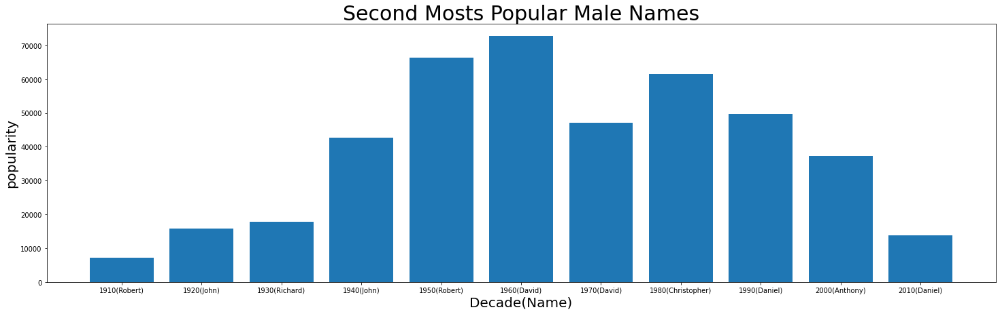

In [30]:
plot_names_popularity(df_male,'Male')

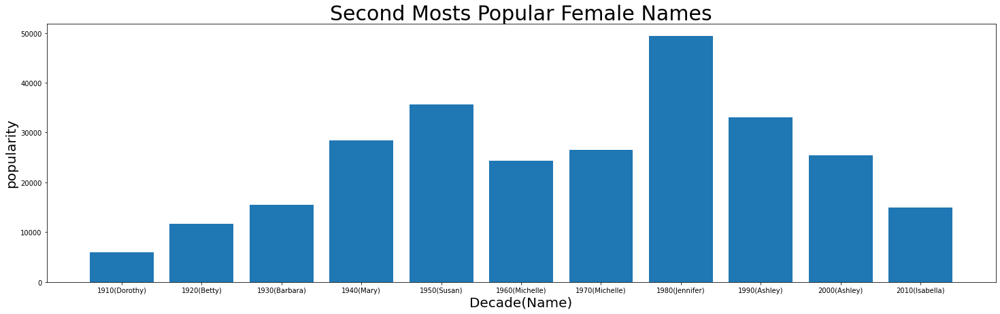

In [31]:
plot_names_popularity(df_female,'Female')

# 2. Flavors of Cacao Dataset (15pt)

Using the [Flavors of Cacao](https://www.kaggle.com/rombikuboktaeder/choco-flavors) dataset, answer the following questions:

**Question 1:** Write a function that returns the number of bars manufactured where the bars' BroadBean Origin is a given country. Use the function to calculate the number of bars where BroadBean Origin is 'Fiji' (15pt)

**Question 2:** Write a function that returns the maximal and average cocoa percentage in a bar manufactured by a company in a specific country. Use the function to calculate the minimal and average cocoa percentage in bars manufactured by a Swiss company (15pt).

**Question 3:** Calculate the second most common bean type(s) and the most rare bean type(s) (15
pt)

**Question 4:** Calculate the number of reviews and the average rating in each year. Calculate the number of reviews and the average rating of each company in each year (15pt)

In [32]:
# Creating a dataset directory
!mkdir ./datasets/flavors_of_cacao 

# download the dataset from Kaggle and unzip it
!kaggle datasets download abhishekpatel/flavors-of-cacaocsv -f flavors_of_cacao.csv -p ./datasets/flavors_of_cacao

  0% 0.00/125k [00:00<?, ?B/s]
100% 125k/125k [00:00<00:00, 58.1MB/s]


In [33]:
db = Database()
db.bind(provider='sqlite', filename='/content/datasets/flavors_of_cacao/flavorsofcacao.pony.db', create_db=True)

GET NEW CONNECTION
RELEASE CONNECTION


In [34]:
class Cacao(db.Entity):
    Company = Required(str)
    ReviewDate = Required(int)
    Rating = Required(float)

In [35]:
set_sql_debug(True) # helps to see what SQL commands are running
db.generate_mapping(create_tables=True) # create tables

GET CONNECTION FROM THE LOCAL POOL
PRAGMA foreign_keys = false
BEGIN IMMEDIATE TRANSACTION
CREATE TABLE "Cacao" (
  "id" INTEGER PRIMARY KEY AUTOINCREMENT,
  "Company" TEXT NOT NULL,
  "ReviewDate" INTEGER NOT NULL,
  "Rating" REAL NOT NULL
)

SELECT "Cacao"."id", "Cacao"."Company", "Cacao"."ReviewDate", "Cacao"."Rating"
FROM "Cacao" "Cacao"
WHERE 0 = 1

COMMIT
PRAGMA foreign_keys = true
CLOSE CONNECTION
RELEASE CONNECTION


In [38]:
df=pd.read_csv('./datasets/flavors_of_cacao/flavors_of_cacao.csv',engine='python')

In [39]:
for idx, row in df.iterrows():
    Cacao(Company=row['Company\xa0\n(Maker-if known)'],ReviewDate=row['Review\nDate'], Rating=row['Rating'])

In [40]:
commit()

Streaming output truncated to the last 5000 lines.

INSERT INTO "Cacao" ("Company", "ReviewDate", "Rating") VALUES (?, ?, ?)
['Artisan du Chocolat', 2010, 3.5]

INSERT INTO "Cacao" ("Company", "ReviewDate", "Rating") VALUES (?, ?, ?)
['Artisan du Chocolat', 2009, 2.5]

INSERT INTO "Cacao" ("Company", "ReviewDate", "Rating") VALUES (?, ?, ?)
['Artisan du Chocolat', 2009, 2.75]

INSERT INTO "Cacao" ("Company", "ReviewDate", "Rating") VALUES (?, ?, ?)
['Artisan du Chocolat', 2009, 1.75]

INSERT INTO "Cacao" ("Company", "ReviewDate", "Rating") VALUES (?, ?, ?)
['Artisan du Chocolat', 2009, 3.0]

INSERT INTO "Cacao" ("Company", "ReviewDate", "Rating") VALUES (?, ?, ?)
['Artisan du Chocolat', 2009, 3.0]

INSERT INTO "Cacao" ("Company", "ReviewDate", "Rating") VALUES (?, ?, ?)
['Artisan du Chocolat', 2009, 3.25]

INSERT INTO "Cacao" ("Company", "ReviewDate", "Rating") VALUES (?, ?, ?)
['Artisan du Chocolat', 2008, 3.75]

INSERT INTO "Cacao" ("Company", "ReviewDate", "Rating") VALUES (?, ?, ?)

In [41]:
con = sqlite3.connect('/content/datasets/flavors_of_cacao/flavorsofcacao.pony.db') 
cur = con.cursor()
num_of_reviews_and_avg_rating_each_year=cur.execute("SELECT ReviewDate, Count(ReviewDate), AVG(Rating) FROM Cacao group by ReviewDate").fetchall()
cur.close()
num_of_reviews_and_avg_rating_each_year

[(2006, 72, 3.125),
 (2007, 77, 3.1623376623376624),
 (2008, 93, 2.9946236559139785),
 (2009, 123, 3.073170731707317),
 (2010, 111, 3.1486486486486487),
 (2011, 165, 3.256060606060606),
 (2012, 195, 3.178205128205128),
 (2013, 184, 3.1970108695652173),
 (2014, 247, 3.1892712550607287),
 (2015, 285, 3.2464912280701754),
 (2016, 219, 3.2260273972602738),
 (2017, 24, 3.3125)]

In [42]:
cur = con.cursor()
num_of_reviews_and_avg_rating_each_comp_year=cur.execute("SELECT Company, ReviewDate, Count(ReviewDate), AVG(Rating) FROM Cacao group by Company, ReviewDate").fetchall()
cur.close()
num_of_reviews_and_avg_rating_each_comp_year

[('A. Morin', 2012, 2, 3.625),
 ('A. Morin', 2013, 11, 3.3181818181818183),
 ('A. Morin', 2014, 5, 3.5),
 ('A. Morin', 2015, 4, 3.1875),
 ('A. Morin', 2016, 1, 3.75),
 ('AMMA', 2010, 4, 3.5625),
 ('AMMA', 2013, 1, 3.25),
 ('Acalli', 2015, 2, 3.75),
 ('Adi', 2011, 4, 3.25),
 ('Aequare (Gianduja)', 2009, 2, 2.875),
 ('Ah Cacao', 2009, 1, 3.0),
 ("Akesson's (Pralus)", 2010, 2, 2.75),
 ("Akesson's (Pralus)", 2011, 1, 3.75),
 ('Alain Ducasse', 2013, 2, 2.5),
 ('Alain Ducasse', 2014, 3, 2.8333333333333335),
 ('Alexandre', 2017, 4, 3.5),
 ('Altus aka Cao Artisan', 2013, 5, 3.0),
 ('Altus aka Cao Artisan', 2016, 5, 2.7),
 ('Amano', 2007, 3, 3.4166666666666665),
 ('Amano', 2008, 1, 2.75),
 ('Amano', 2009, 1, 3.0),
 ('Amano', 2010, 3, 3.5833333333333335),
 ('Amano', 2011, 1, 4.0),
 ('Amatller (Simon Coll)', 2009, 4, 2.875),
 ('Amazona', 2013, 2, 3.375),
 ('Ambrosia', 2015, 6, 3.25),
 ('Amedei', 2006, 2, 4.5),
 ('Amedei', 2007, 10, 3.725),
 ('Amedei', 2012, 1, 3.75),
 ('Anahata', 2014, 1, 3.0),
 

# 3. Kickstarter Projects Dataset (25pt)

Using the [Kickstarter Projects Dataset](https://www.kaggle.com/kemical/kickstarter-projects#ks-projects-201801.csv), answer the following questions:

**Task 1 (for everyone):** Load the dataset to SQLite DB using [PonyORM](https://ponyorm.org) (10pt)

In [43]:
# Creating a dataset directory
!mkdir ./datasets/kickstarter_projects

# download the dataset from Kaggle and unzip it
!kaggle datasets download kemical/kickstarter-projects -f ks-projects-201801.csv -p ./datasets/kickstarter_projects
!unzip ./datasets/kickstarter_projects/*.zip  -d ./datasets/kickstarter_projects

 25% 5.00M/20.4M [00:00<00:00, 47.4MB/s]
100% 20.4M/20.4M [00:00<00:00, 99.4MB/s]
Archive:  ./datasets/kickstarter_projects/ks-projects-201801.csv.zip
  inflating: ./datasets/kickstarter_projects/ks-projects-201801.csv  


In [44]:
db = Database()
db.bind(provider='sqlite', filename='/content/datasets/kickstarter_projects/ks-projects-201801.pony.db', create_db=True)

GET NEW CONNECTION
RELEASE CONNECTION


In [45]:
class Project(db.Entity):
    ID = PrimaryKey(int)
    name = Optional(str)
    category = Optional(str)
    main_category = Optional(str)
    currency = Optional(str)
    deadline = Optional(str)
    goal = Optional(float)
    launched = Required(str)
    pledged = Optional(float)
    state = Optional(str)
    backers = Optional(int)
    country = Optional(str)
    usd_pledged = Optional(float)
    usd_pledged_real = Optional(float)
    usd_goal_real = Optional(float)

In [46]:
set_sql_debug(True) # helps to see what SQL commands are running
db.generate_mapping(create_tables=True) # create tables

GET CONNECTION FROM THE LOCAL POOL
PRAGMA foreign_keys = false
BEGIN IMMEDIATE TRANSACTION
CREATE TABLE "Project" (
  "ID" INTEGER NOT NULL PRIMARY KEY,
  "name" TEXT NOT NULL,
  "category" TEXT NOT NULL,
  "main_category" TEXT NOT NULL,
  "currency" TEXT NOT NULL,
  "deadline" TEXT NOT NULL,
  "goal" REAL,
  "launched" TEXT NOT NULL,
  "pledged" REAL,
  "state" TEXT NOT NULL,
  "backers" INTEGER,
  "country" TEXT NOT NULL,
  "usd_pledged" REAL,
  "usd_pledged_real" REAL,
  "usd_goal_real" REAL
)

SELECT "Project"."ID", "Project"."name", "Project"."category", "Project"."main_category", "Project"."currency", "Project"."deadline", "Project"."goal", "Project"."launched", "Project"."pledged", "Project"."state", "Project"."backers", "Project"."country", "Project"."usd_pledged", "Project"."usd_pledged_real", "Project"."usd_goal_real"
FROM "Project" "Project"
WHERE 0 = 1

COMMIT
PRAGMA foreign_keys = true
CLOSE CONNECTION
RELEASE CONNECTION


In [47]:
df=pd.read_csv('./datasets/kickstarter_projects/ks-projects-201801.csv',engine='python')
for idx, row in df.iterrows():
    Project(ID=row['ID'],
            name=str(row['name']),
            category=row['category'],
            main_category=row['main_category'],
            currency=row['currency'],
            deadline=row['deadline'],
            goal=row['goal'],
            launched=row['launched'],
            pledged=row['pledged'],
            state=row['state'],
            backers=row['backers'],
            country=row['country'],
            usd_pledged=row['usd pledged'],
            usd_pledged_real=row['usd_pledged_real'],
            usd_goal_real=row['usd_goal_real']
            )
commit()

Streaming output truncated to the last 5000 lines.
[1020945925, 'Help me "Turn Up the Volume on God!" with my new book!', 'Publishing', 'Publishing', 'USD', '2017-07-06', 10000.0, '2017-06-06 14:42:29', 0.0, 'failed', 0, 'US', 0.0, 0.0, 10000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1020946076, 'City of Zombies: A Board Game that takes brains to survive', 'Tabletop Games', 'Games', 'GBP', '2013-11-03', 15000.0, '2013-10-04 22:11:07', 1652.44, 'canceled', 50, 'GB', 2676.92, 2657.17, 24120.41]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1020951290, 'The Secret

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1078182673, '"Infected" A zombie survival card game', 'Playing Cards', 'Games', 'CAD', '2015-03-28', 10000.0, '2015-02-26 09:19:28', 225.0, 'failed', 8, 'CA', 180.19, 177.95, 7908.89]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1078188997, 'Headwaters Academy Aquaponics System (JK - Gr 6 Elementary)', 'Food', 'Food', 'CAD', '2017-10-03', 450.0, '2017-09-26 22:00:19', 715.0, 'successful', 13, 'CA', 437.87, 568.59, 357.85]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1078198745, 'Eliminate Passwords for Secure Googl

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1133540581, 'ANDY DAVIS passes the hat around to fund a BRAND NEW RECORD!', 'Indie Rock', 'Music', 'USD', '2011-02-24', 30000.0, '2011-01-25 07:03:48', 41347.87, 'successful', 575, 'US', 41347.87, 41347.87, 30000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1133540953, 'Candidate Verification', 'Web', 'Technology', 'USD', '2015-06-20', 20000.0, '2015-05-06 15:46:23', 0.0, 'failed', 0, 'US', 0.0, 0.0, 20000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1133551828, 'Star Crush Starship Miniatures Production', 'T

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1186277605, 'Let\'s press a 45 rpm 7" single!', 'Indie Rock', 'Music', 'USD', '2016-01-11', 800.0, '2015-12-12 15:22:15', 800.0, 'successful', 12, 'US', 800.0, 800.0, 800.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1186281027, 'Peanut Gallery Comics', 'Comic Books', 'Comics', 'USD', '2016-03-04', 3200.0, '2016-01-29 02:20:23', 6730.0, 'successful', 126, 'US', 6730.0, 6730.0, 3200.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1186289466, 'The CurlBand-a fast, easy, and heatless way to salon curls', 'Product De

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1240191590, 'SleepOvation: 700 Tiny Mattresses in One', 'Product Design', 'Design', 'USD', '2017-09-01', 10000.0, '2017-08-01 13:50:42', 14914.0, 'successful', 57, 'US', 883.0, 14914.0, 10000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1240194608, 'Long Night', 'Video Games', 'Games', 'CAD', '2014-01-16', 10000.0, '2013-12-12 01:52:19', 12507.0, 'successful', 189, 'CA', 11759.66, 11402.13, 9116.6]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1240214644, 'A TALE TOLD BY AN IDIOT: an experiment in fusing live the

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[12916137, 'Catcher & Co Small Batch Craft Distillery', 'Drinks', 'Food', 'AUD', '2014-08-22', 5000.0, '2014-08-01 03:21:47', 1544.0, 'failed', 20, 'AU', 1448.61, 1437.75, 4655.93]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1291616579, 'A New Album by Bryce Larsen', 'Indie Rock', 'Music', 'USD', '2012-08-13', 20000.0, '2012-07-16 05:12:11', 23732.72, 'successful', 315, 'US', 23732.72, 23732.72, 20000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "c

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1345774097, 'Leonardo and Adonis (Canceled)', 'Webseries', 'Film & Video', 'USD', '2014-12-15', 8000.0, '2014-11-05 20:51:40', 85.0, 'canceled', 16, 'US', 85.0, 85.0, 8000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1345783197, 'Aphrodite Entertainment Dance Troupe', 'Performances', 'Dance', 'USD', '2015-01-11', 2000.0, '2014-12-12 20:00:49', 63.0, 'failed', 6, 'US', 63.0, 63.0, 2000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "dea

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[139761610, 'LIFE: Web Series (Canceled)', 'Webseries', 'Film & Video', 'USD', '2015-04-01', 6000.0, '2015-02-17 00:55:28', 50.0, 'canceled', 1, 'US', 50.0, 50.0, 6000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1397619267, "Tinker' A Feature Film Written and Directed By Sonny Marler", 'Science Fiction', 'Film & Video', 'USD', '2014-08-16', 100000.0, '2014-07-17 20:02:33', 101860.0, 'successful', 267, 'US', 101860.0, 101860.0, 100000.0]

INSERT INTO "Project" ("ID", "na

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1429709836, 'Tim Carey & Amanda Taylor - First EP', 'Music', 'Music', 'USD', '2016-04-01', 6000.0, '2016-02-09 22:12:11', 7231.0, 'undefined', 0, 'N,0"', nan, 7231.0, 6000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1429717501, 'ALONE - WWII Action Short Film', 'Action', 'Film & Video', 'USD', '2017-11-23', 2000.0, '2017-10-24 00:14:47', 194.0, 'failed', 7, 'US', 0.0, 194.0, 2000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadlin

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1454364335, 'Help Andrew Sheron pay for his first full-length album!', 'Indie Rock', 'Music', 'USD', '2010-11-21', 2500.0, '2010-10-22 01:11:11', 985.0, 'failed', 25, 'US', 985.0, 985.0, 2500.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1454366377, 'Find My Rock Adventure game', 'Live Games', 'Games', 'USD', '2016-02-10', 75000.0, '2016-01-10 06:40:31', 1.0, 'failed', 1, 'US', 1.0, 1.0, 75000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1454370687, 'Dead Dog, a short film by Bryan Arrigo and Brook Whitmore.',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1481825833, 'oaferten - Daylight Robbery', 'Music', 'Music', 'USD', '2015-02-11', 60.0, '2015-01-30 18:21:04', 80.0, 'successful', 7, 'US', 80.0, 80.0, 60.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1481828091, 'Burning Man Bluegrass Project', 'Country & Folk', 'Music', 'USD', '2014-08-22', 3500.0, '2014-07-23 16:08:30', 3533.0, 'successful', 24, 'US', 3533.0, 3533.0, 3500.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "go

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[150600503, "Emma Warren's Debut EP", 'Faith', 'Music', 'USD', '2016-12-09', 10000.0, '2016-11-04 02:42:03', 11625.0, 'successful', 115, 'US', 845.0, 11625.0, 10000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1506014338, 'cheap travel trew the North Island of NZ', 'Video', 'Journalism', 'NZD', '2014-11-05', 100.0, '2014-10-21 03:32:31', 0.0, 'failed', 0, 'NZ', 0.0, 0.0, 76.99]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "go

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1535131395, 'Bobo', 'Comics', 'Comics', 'USD', '2017-03-08', 1500.0, '2017-02-06 21:27:01', 22.0, 'failed', 3, 'US', 16.0, 22.0, 1500.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1535137325, 'A Wordless Fable (Canceled)', 'Comics', 'Comics', 'USD', '2013-03-07', 5000.0, '2013-02-05 01:32:01', 265.0, 'canceled', 7, 'US', 265.0, 265.0, 5000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1535144888, 'Secrets in the Woods (when love, murder & power is involved)', 'Publishing', 'Publishing', 'USD', '2017-09-19', 120

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1562684364, 'Waiting To Die, 3rd Album by The Frozen Hellsicles!', 'Indie Rock', 'Music', 'USD', '2017-02-15', 3500.0, '2017-01-16 22:26:52', 3500.0, 'successful', 42, 'US', 895.0, 3500.0, 3500.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1562689365, 'La Petite Culinarian "The Little Chef"', 'Spaces', 'Food', 'USD', '2015-03-01', 50000.0, '2015-01-30 14:52:18', 277.0, 'failed', 5, 'US', 277.0, 277.0, 50000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_categ

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1589200021, 'Lady with red stilletos', 'Shorts', 'Film & Video', 'GBP', '2013-07-19', 1000.0, '2013-06-19 16:31:10', 10.0, 'failed', 1, 'GB', 15.71, 15.26, 1526.02]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1589201282, 'Tuesdays With Morrie starring Jamie Farr', 'Plays', 'Theater', 'USD', '2016-05-24', 4500.0, '2016-05-10 15:19:14', 0.0, 'failed', 0, 'US', 0.0, 0.0, 4500.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[158920462, 'Radio', 'Plays', 'Theater', 'GBP', '2017-07-24', 1750.0, '2017-07-17 12:37:47', 190

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1640970253, 'THE POLAR BEAR CLUB', 'Narrative Film', 'Film & Video', 'USD', '2012-03-13', 15000.0, '2012-01-13 18:19:38', 15162.0, 'successful', 52, 'US', 15162.0, 15162.0, 15000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[164097792, 'mod|todd life styles by The Modern Toddler', 'Childrenswear', 'Fashion', 'USD', '2016-09-17', 5000.0, '2016-08-04 01:02:49', 1.0, 'failed', 1, 'US', 0.0, 1.0, 5000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "cur

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1694807742, 'Wabi Sabi, the Beauty of the Unconventional', 'Painting', 'Art', 'USD', '2012-12-01', 400.0, '2012-11-12 19:06:51', 410.42, 'successful', 15, 'US', 410.42, 410.42, 400.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1694808945, 'THE DEAD PRESIDENTS (Canceled)', 'Comics', 'Comics', 'USD', '2013-08-05', 10000.0, '2013-07-04 09:04:32', 2680.0, 'canceled', 54, 'US', 2680.0, 2680.0, 10000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "curren

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1753599667, 'Astoria Music Now! 2011', 'Mixed Media', 'Art', 'USD', '2011-07-05', 3500.0, '2011-04-19 23:02:40', 641.0, 'failed', 17, 'US', 641.0, 641.0, 3500.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1753601469, 'Sticky - The Pilot', 'Shorts', 'Film & Video', 'USD', '2012-09-18', 12000.0, '2012-08-10 23:17:26', 300.0, 'failed', 10, 'US', 300.0, 300.0, 12000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launche

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1806106, 'The Revolution Exhibition', 'Art', 'Art', 'CAD', '2014-12-19', 5000.0, '2014-11-21 01:11:36', 365.0, 'failed', 8, 'CA', 322.35, 314.76, 4311.83]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1806109377, 'The Academy: Mockumentary Sitcom TV Pilot', 'Television', 'Film & Video', 'USD', '2016-04-17', 500.0, '2016-03-18 03:29:04', 629.99, 'successful', 20, 'US', 629.99, 629.99, 500.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1806114726, '• My first dream short film • Mon premier court métrage •', 'Film & V

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1860709332, 'Johnoscar Christmas (Canceled)', 'Music', 'Music', 'USD', '2013-11-12', 12500.0, '2013-10-22 23:50:04', 4400.0, 'canceled', 24, 'US', 4400.0, 4400.0, 12500.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1860713915, 'AK Athletic Kit', 'Product Design', 'Design', 'CAD', '2015-02-28', 30000.0, '2015-01-18 16:24:53', 10106.0, 'failed', 55, 'CA', 8436.8, 8106.85, 24065.46]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1920296135, 'WOLF short horror film', 'Shorts', 'Film & Video', 'GBP', '2014-08-09', 2000.0, '2014-07-10 12:22:08', 2597.0, 'successful', 73, 'GB', 4448.31, 4334.4, 3338.01]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1920296851, 'Fringe Focus Poster Prints!', 'Illustration', 'Art', 'USD', '2011-03-17', 2000.0, '2011-02-14 16:11:14', 4472.0, 'successful', 94, 'US', 4472.0, 4472.0, 2000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "dead

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[198018680, 'CreaToys', 'DIY', 'Crafts', 'MXN', '2017-05-26', 27000.0, '2017-04-26 18:28:40', 1300.0, 'failed', 5, 'MX', 5.33, 70.37, 1461.51]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1980205914, 'FLY ON THE WINGS OF LOVE', 'Shorts', 'Film & Video', 'USD', '2012-07-30', 3500.0, '2012-07-23 23:34:03', 5275.0, 'successful', 51, 'US', 5275.0, 5275.0, 3500.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pled

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[205077710, 'GRasPi - a Raspberry-Pi based guitar amplifier', 'Technology', 'Technology', 'EUR', '2016-12-31', 35000.0, '2016-12-01 20:49:41', 330.0, 'canceled', 2, 'IT', 0.0, 349.44, 37061.35]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[2050795496, 'NEED New York!', 'Fashion', 'Fashion', 'USD', '2012-06-09', 1489.5, '2012-05-10 20:12:03', 1595.0, 'successful', 38, 'US', 1595.0, 1595.0, 1489.5]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[2104873664, "Be a part of Bobby Zee's First Spiritual CD", 'Music', 'Music', 'USD', '2011-09-07', 15000.0, '2011-07-09 02:06:03', 335.0, 'failed', 3, 'US', 335.0, 335.0, 15000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[2104895481, 'Wallstrides', 'People', 'Photography', 'USD', '2015-11-02', 5000.0, '2015-10-19 23:04:50', 422.0, 'failed', 8, 'US', 422.0, 422.0, 5000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "l

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[229861105, 'The Baku Graphic Novel Horror Western Awesomeness!', 'Comics', 'Comics', 'USD', '2011-04-25', 1250.0, '2011-03-15 18:42:12', 3979.0, 'successful', 160, 'US', 3979.0, 3979.0, 1250.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[229870901, 'in Sanity, AZ - Horror Comic Book Anthology', 'Comics', 'Comics', 'USD', '2013-03-03', 9876.0, '2013-01-29 00:11:46', 10208.37, 'successful', 206, 'US', 10208.37, 10208.37, 9876.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[229871422, 'Mystix Mapping System - Static 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[285733317, 'New England Fall Journal', 'Places', 'Photography', 'USD', '2015-10-19', 4000.0, '2015-09-19 09:35:10', 0.0, 'failed', 0, 'US', 0.0, 0.0, 4000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[285734277, 'Red Raven Meadery', 'Drinks', 'Food', 'USD', '2017-09-12', 10000.0, '2017-07-14 06:02:04', 21.0, 'failed', 2, 'US', 0.0, 21.0, 10000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "sta

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[337881346, 'Winged Moai Enamel Pin.', 'Accessories', 'Fashion', 'USD', '2016-09-11', 350.0, '2016-08-11 21:21:36', 388.0, 'successful', 23, 'US', 119.0, 388.0, 350.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[337885554, 'Forex Around Australia', 'Publishing', 'Publishing', 'AUD', '2014-06-12', 64620.0, '2014-05-22 05:29:56', 5040.0, 'failed', 4, 'AU', 4690.86, 4732.39, 60676.06]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[337888849, 'FlameFrost: the Pocket MMORPG', 'Video Games', 'Games', 'GBP', '2015-08-07', 1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[390522129, 'Lugabug Child Travel Chair', 'Product Design', 'Design', 'USD', '2015-02-28', 25000.0, '2015-01-14 07:42:50', 25266.0, 'successful', 196, 'US', 25266.0, 25266.0, 25000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[390525628, 'Brim-It hat clips (Canceled)', 'Product Design', 'Design', 'USD', '2014-07-23', 10000.0, '2014-06-23 23:13:19', 81.0, 'canceled', 8, 'US', 81.0, 81.0, 10000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[390526031, 'SJ Custom Art', 'Art', 'Art', 'CAD', '2016-04-29', 100.0, '2016

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[441054811, 'Mediterranean Gardening and Outdoor Living Magazine', 'Periodicals', 'Publishing', 'GBP', '2017-11-05', 28250.0, '2017-10-06 18:15:45', 6.0, 'failed', 1, 'GB', 0.0, 7.91, 37255.37]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[441057066, '"The Three"', 'Shorts', 'Film & Video', 'USD', '2014-03-04', 2500.0, '2014-02-03 14:45:04', 2630.0, 'successful', 35, 'US', 2630.0, 2630.0, 2500.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[441060346, 'New EP/Music Development', 'Music', 'Music', 'USD', '2016-05-20',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[499891622, 'Get me into a recording studio', 'Music', 'Music', 'USD', '2015-04-23', 1000.0, '2015-03-24 00:34:32', 171.0, 'failed', 6, 'US', 171.0, 171.0, 1000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[499893455, 'Single dad of little "Amina" as a male model in New York', 'People', 'Photography', 'EUR', '2016-02-28', 1600.0, '2016-01-14 01:49:29', 1.0, 'failed', 1, 'DE', 1.09, 1.1, 1755.19]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[499911971, 'The Astonix Clothing Project', 'Fashion', 'Fashion', 'USD', '20

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[554019144, 'In the Field', 'Shorts', 'Film & Video', 'USD', '2017-03-19', 7500.0, '2017-02-17 18:54:50', 485.0, 'canceled', 5, 'US', 335.0, 485.0, 7500.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[554020860, 'The Stonehenge Files', 'Fiction', 'Publishing', 'USD', '2015-12-25', 10000.0, '2015-10-26 19:15:00', 120.0, 'failed', 2, 'US', 120.0, 120.0, 10000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[554026310, 'THE SILENT DARKNESS: RISE OF THE WITCH', 'Narrative Film', 'Film & Video', 'USD', '2012-09-18', 10000

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[613217016, 'Geschichte in Farbe, History in Colors', 'Digital Art', 'Art', 'EUR', '2017-06-14', 4000.0, '2017-05-15 11:04:32', 170.0, 'failed', 1, 'AT', 185.84, 189.84, 4466.78]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[613220037, 'Sustainability Theory - Food: An E-book To Help End Hunger', 'Publishing', 'Publishing', 'USD', '2015-05-21', 7000.0, '2015-04-21 21:03:07', 20.0, 'undefined', 0, 'N,0"', nan, 20.0, 7000.0]

INSERT INTO "Project" ("ID", "name", "category", "m

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[670747693, 'The Dear Harry Project', 'Nonfiction', 'Publishing', 'USD', '2012-12-17', 5000.0, '2012-11-16 13:37:15', 5130.0, 'successful', 27, 'US', 5130.0, 5130.0, 5000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[670757871, 'SANCTUARY OF JESUS', 'Painting', 'Art', 'USD', '2013-07-01', 5000.0, '2013-06-01 20:29:28', 301.0, 'failed', 3, 'US', 301.0, 301.0, 5000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launche

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[731880015, 'Brevard Academy Travel Band Performing at Disney World', 'Music', 'Music', 'USD', '2015-03-04', 8500.0, '2015-02-02 16:14:30', 86.0, 'undefined', 0, 'N,0"', nan, 86.0, 8500.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[731880161, "Inmundane's Full Length Album (And Music Video)!", 'Indie Rock', 'Music', 'USD', '2012-11-15', 1100.0, '2012-10-11 23:06:40', 1652.0, 'successful', 36, 'US', 1652.0, 1652.0, 1100.0]

INSERT INTO "Project" ("ID", "name", "category", 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[792490126, 'PakRoller: BIGGEST advancement in shipping', 'Product Design', 'Design', 'USD', '2015-06-02', 1500.0, '2015-04-03 18:02:20', 1503.0, 'successful', 34, 'US', 1503.0, 1503.0, 1500.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[792493226, 'Fashion Photography Book', 'Photography', 'Photography', 'USD', '2011-04-09', 850.0, '2011-03-09 21:00:32', 911.0, 'successful', 26, 'US', 911.0, 911.0, 850.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[851795960, 'Bicycle® Deco - Custom Playing Cards from Encarded', 'Tabletop Games', 'Games', 'USD', '2013-07-29', 1000.0, '2013-07-01 17:59:01', 29223.95, 'successful', 712, 'US', 29223.95, 29223.95, 1000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[85180051, 'Global Warming Solution - Book titled "Yes We Can !"', 'Nonfiction', 'Publishing', 'USD', '2016-11-01', 7000.0, '2016-09-02 19:35:47', 159.0, 'failed', 5, 'US', 0.0, 159.0, 7000.0]

INSERT INTO "Project" ("ID", "na

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[898241461, 'Fuzzy The Cat', 'Fashion', 'Fashion', 'USD', '2013-05-20', 10000.0, '2013-03-21 20:54:38', 60.0, 'failed', 3, 'US', 60.0, 60.0, 10000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[898246779, 'The Smiley Series Cursor Collection', 'Digital Art', 'Art', 'USD', '2017-04-29', 98.0, '2017-04-14 19:06:58', 1.0, 'failed', 1, 'US', 0.0, 1.0, 98.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged",

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[93821497, 'The Kilimanjaro Project', 'Film & Video', 'Film & Video', 'USD', '2011-05-11', 15000.0, '2011-03-11 23:43:05', 3306.0, 'failed', 34, 'US', 3306.0, 3306.0, 15000.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[938227404, 'EDC Ink –“Every Day Carry” Keychain Pen – Go-With-You Art', 'Product Design', 'Design', 'USD', '2014-12-05', 10000.0, '2014-11-04 11:01:00', 78621.0, 'successful', 1107, 'US', 78621.0, 78621.0, 10000.0]

INSERT INTO "Project" ("ID", "name", "cat

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[991514454, "Spy in the Teachers' Lounge - Illustrated Young Adult Novel", 'Young Adult', 'Publishing', 'USD', '2015-08-24', 1500.0, '2015-07-16 05:58:11', 280.0, 'failed', 8, 'US', 280.0, 280.0, 1500.0]

INSERT INTO "Project" ("ID", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[991514477, 'Double Barrel Theatre Presents 2015', 'Webcomics', 'Comics', 'USD', '2014-08-27', 500.0, '2014-07-28 11:39:02', 1.0, 'failed', 1, 'US', 1.0, 1.0, 500.0]

INSERT INTO "Project" ("ID", "name", "category", "main_categor

### <span style="color:red"> Please answer only **one** of the following questions according to your ID number (use the formula **<YOUR_ID> mod 3 +1**) </span>

In [48]:
# which question to answer - put your ID number and run the code 
your_id  = "203842703"
q = int(your_id) % 3 + 1
print("You need to answer question number %s" % q)

You need to answer question number 3


**Question 1:** On average which project category received the highest number of backers? (15 pt)

**Question 2:** On average which project category received the highest pledged USD? (15 pt)

**Question 3:** In which month occurred the highest number of projects? (15 pt)

In [49]:
con = sqlite3.connect('/content/datasets/kickstarter_projects/ks-projects-201801.pony.db') 
cur = con.cursor()
num_of_projects_for_month=cur.execute('SELECT strftime("%m-%Y", launched) Month, Count(strftime("%m-%Y", launched)) Num_Of_Projects FROM Project GROUP BY strftime("%m-%Y", launched)').fetchall()
cur.close()
num_of_projects_for_month[-1]
print("The Month with the Highest number of projects is {} with {} projects".format(num_of_projects_for_month[-1][0].split('-')[0],num_of_projects_for_month[-1][1]))

The Month with the Highest number of projects is 12 with 2751 projects


## 4. Oscars Datasets (10pt)

Using the [Oscars Dataset](https://www.kaggle.com/theacademy/academy-awards), please answer only one of the following questions (you can chose):

In [50]:
# Creating a dataset directory
!mkdir ./datasets/academy_awards

# download the dataset from Kaggle and unzip it
!kaggle datasets download theacademy/academy-awards -f database.csv -p ./datasets/academy_awards

  0% 0.00/775k [00:00<?, ?B/s]
100% 775k/775k [00:00<00:00, 66.9MB/s]


In [51]:
db = Database()
db.bind(provider='sqlite', filename='/content/datasets/academy_awards/academy_awards.pony.db', create_db=True)

GET NEW CONNECTION
RELEASE CONNECTION


In [52]:
class OscarNominees(db.Entity):
    year = Optional(str)
    ceremony = Optional(int)
    award = Required(str)
    winner = Optional(float)
    name = Required(str)
    film = Optional(str)

In [55]:
set_sql_debug(True) # helps to see what SQL commands are running
db.generate_mapping(create_tables=True) # create tables

GET CONNECTION FROM THE LOCAL POOL
PRAGMA foreign_keys = false
BEGIN IMMEDIATE TRANSACTION
CREATE TABLE "OscarNominees" (
  "id" INTEGER PRIMARY KEY AUTOINCREMENT,
  "year" TEXT NOT NULL,
  "ceremony" INTEGER,
  "award" TEXT NOT NULL,
  "winner" REAL,
  "name" TEXT NOT NULL,
  "film" TEXT NOT NULL
)

SELECT "OscarNominees"."id", "OscarNominees"."year", "OscarNominees"."ceremony", "OscarNominees"."award", "OscarNominees"."winner", "OscarNominees"."name", "OscarNominees"."film"
FROM "OscarNominees" "OscarNominees"
WHERE 0 = 1

COMMIT
PRAGMA foreign_keys = true
CLOSE CONNECTION
RELEASE CONNECTION


In [53]:
df=pd.read_csv('./datasets/academy_awards/database.csv',engine='python')

In [56]:
for idx, row in df.iterrows():
    OscarNominees(year=row['Year'],
            ceremony=row['Ceremony'],
            award=row['Award'],
            winner=row['Winner'],
            name=row['Name'],
            film=str(row['Film'])
            )
commit()

Streaming output truncated to the last 5000 lines.

INSERT INTO "OscarNominees" ("year", "ceremony", "award", "winner", "name", "film") VALUES (?, ?, ?, ?, ?, ?)
['2002', 75, 'Actress in a Supporting Role', 1.0, 'Catherine Zeta-Jones', 'Chicago']

INSERT INTO "OscarNominees" ("year", "ceremony", "award", "winner", "name", "film") VALUES (?, ?, ?, ?, ?, ?)
['2002', 75, 'Animated Feature Film', nan, 'Ice Age', 'Chris Wedge']

INSERT INTO "OscarNominees" ("year", "ceremony", "award", "winner", "name", "film") VALUES (?, ?, ?, ?, ?, ?)
['2002', 75, 'Animated Feature Film', nan, 'Lilo & Stitch', 'Chris Sanders']

INSERT INTO "OscarNominees" ("year", "ceremony", "award", "winner", "name", "film") VALUES (?, ?, ?, ?, ?, ?)
['2002', 75, 'Animated Feature Film', nan, 'Spirit: Stallion of the Cimarron', 'Jeffrey Katzenberg']

INSERT INTO "OscarNominees" ("year", "ceremony", "award", "winner", "name", "film") VALUES (?, ?, ?, ?, ?, ?)
['2002', 75, 'Animated Feature Film', 1.0, 'Spirited Away', 'H

**Question 1:** Who is the male actress with the most Oscar nominees? (10pt)

In [57]:
con = sqlite3.connect('/content/datasets/academy_awards/academy_awards.pony.db') 
cur = con.cursor()
num_of_nominees_for_Actor=cur.execute("SELECT Name, Count(Award) Num_of_nominees FROM OscarNominees WHERE Award Like '%Actor%' GROUP BY Name ORDER BY Num_of_nominees").fetchall()
cur.close()
num_of_nominees_for_Actor[-1]
print("The Actor with the Highest number of nominees is {} with {} nominees".format(num_of_nominees_for_Actor[-1][0],num_of_nominees_for_Actor[-1][1]))

The Actor with the Highest number of nominees is Jack Nicholson with 12 nominees


**Question 2:** Who is the female director with the most Oscar nominees? (10pt)

**Question 3:** Which top-10 movies received the highest number of Oscar nominees? (10pt)

**Question 4:** Write a function that receives an actor's name and returns the actor’s number of Oscar nominees. Use the function to calculate the number of times Leonardo DiCaprio was a nominee (10pt)

## 5. Select a Dataset (15pt)

**Open Question:** Select an interesting dataset and use SQL to discover something interesting (15pt). **Bonus:** Use BigQuery (2pt)

In [58]:
# Creating a dataset directory
!mkdir ./datasets/fifa21

# download the dataset from Kaggle and unzip it
!kaggle datasets download -d ekrembayar/fifa-21-complete-player-dataset -f fifa21_male2.csv -p ./datasets/fifa21
!unzip ./datasets/fifa21/*.zip  -d ./datasets/fifa21

  0% 0.00/2.85M [00:00<?, ?B/s]
100% 2.85M/2.85M [00:00<00:00, 95.5MB/s]
Archive:  ./datasets/fifa21/fifa21_male2.csv.zip
  inflating: ./datasets/fifa21/fifa21_male2.csv  


In [59]:
db = Database()
db.bind(provider='sqlite', filename='/content/datasets/fifa21/fifa21.pony.db', create_db=True)

GET NEW CONNECTION
RELEASE CONNECTION


In [60]:
class Player(db.Entity):
    Name = Required(str)
    Age = Required(int)
    OVA = Required(int)
    Nationality = Required(str)
    Club = Optional(str)
    BOV = Required(int)
    BP = Required(str)
    Position = Required(str)
    Player_Photo = Optional(str)
    POT = Required(int)
    Height = Required(str)
    Weight = Required(str)
    foot = Required(str)

In [61]:
set_sql_debug(True) # helps to see what SQL commands are running
db.generate_mapping(create_tables=True) # create tables

GET CONNECTION FROM THE LOCAL POOL
PRAGMA foreign_keys = false
BEGIN IMMEDIATE TRANSACTION
CREATE TABLE "Player" (
  "id" INTEGER PRIMARY KEY AUTOINCREMENT,
  "Name" TEXT NOT NULL,
  "Age" INTEGER NOT NULL,
  "OVA" INTEGER NOT NULL,
  "Nationality" TEXT NOT NULL,
  "Club" TEXT NOT NULL,
  "BOV" INTEGER NOT NULL,
  "BP" TEXT NOT NULL,
  "Position" TEXT NOT NULL,
  "Player_Photo" TEXT NOT NULL,
  "POT" INTEGER NOT NULL,
  "Height" TEXT NOT NULL,
  "Weight" TEXT NOT NULL,
  "foot" TEXT NOT NULL
)

SELECT "Player"."id", "Player"."Name", "Player"."Age", "Player"."OVA", "Player"."Nationality", "Player"."Club", "Player"."BOV", "Player"."BP", "Player"."Position", "Player"."Player_Photo", "Player"."POT", "Player"."Height", "Player"."Weight", "Player"."foot"
FROM "Player" "Player"
WHERE 0 = 1

COMMIT
PRAGMA foreign_keys = true
CLOSE CONNECTION
RELEASE CONNECTION


In [62]:
df=pd.read_csv('./datasets/fifa21/fifa21_male2.csv',engine='python')

In [63]:
for idx, row in df.iterrows():
    Player(Name=row['Name'],
            Age=row['Age'],
            OVA=row['OVA'],
            Nationality=str(row['Nationality']),
            Club=str(row['Club']),
            BOV=row['BOV'],
            BP=row['Name'],
            Position=str(row['Position']),
            Player_Photo=str(row['Player Photo']),
            POT=row['POT'],
            Height=str(row['Height']),
            Weight=str(row['Weight']),
            foot=row['foot']
            )
commit()

Streaming output truncated to the last 5000 lines.
['M. Lackner', 29, 67, 'Austria', 'SV Ried', 67, 'M. Lackner', 'CDM CM CB', 'https://cdn.sofifa.com/players/212/418/20_120.png', 67, '6\'2"', '176lbs', 'Right']

INSERT INTO "Player" ("Name", "Age", "OVA", "Nationality", "Club", "BOV", "BP", "Position", "Player_Photo", "POT", "Height", "Weight", "foot") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
['T. Mings', 27, 75, 'England', 'Aston Villa', 77, 'T. Mings', 'CB', 'https://cdn.sofifa.com/players/212/419/20_120.png', 78, '6\'5"', '170lbs', 'Left']

INSERT INTO "Player" ("Name", "Age", "OVA", "Nationality", "Club", "BOV", "BP", "Position", "Player_Photo", "POT", "Height", "Weight", "foot") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
['M. Sarr', 26, 68, 'Senegal', 'Huddersfield Town', 70, 'M. Sarr', 'CB LB', 'https://cdn.sofifa.com/players/212/420/20_120.png', 71, '6\'5"', '196lbs', 'Left']

INSERT INTO "Player" ("Name", "Age", "OVA", "Nationality", "Club", "BOV", "BP", "Position", 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.

INSERT INTO "Player" ("Name", "Age", "OVA", "Nationality", "Club", "BOV", "BP", "Position", "Player_Photo", "POT", "Height", "Weight", "foot") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
['E. Rivas', 18, 61, 'Venezuela', 'Estudiantes de Mérida', 63, 'E. Rivas', 'ST', 'https://cdn.sofifa.com/players/253/732/20_120.png', 74, '6\'2"', '170lbs', 'Right']

INSERT INTO "Player" ("Name", "Age", "OVA", "Nationality", "Club", "BOV", "BP", "Position", "Player_Photo", "POT", "Height", "Weight", "foot") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
['Antoñín', 20, 68, 'Spain', 'Granada CF', 70, 'Antoñín', 'ST LM RM', 'https://cdn.sofifa.com/players/253/735/20_120.png', 77, '6\'0"', '157lbs', 'Right']

INSERT INTO "Player" ("Name", "Age", "OVA", "Nationality", "Club", "BOV", "BP", "Position", "Player_Photo", "POT", "Height", "Weight", "foot") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
['R. Alves', 18, 53, 'Switzerland', 'Servette FC', 56, 

Display the top N players by overall rating

In [64]:
def get_top_N_Players(N):
  con = sqlite3.connect('/content/datasets/fifa21/fifa21.pony.db') 
  cur = con.cursor()
  topN_players=cur.execute("SELECT Name, OVA FROM Player ORDER BY OVA DESC".format(N)).fetchall()
  cur.close()
  return topN_players[0:N]
get_top_N_Players(5)

[('L. Messi', 93),
 ('Cristiano Ronaldo', 92),
 ('R. Lewandowski', 91),
 ('Neymar Jr', 91),
 ('K. De Bruyne', 91)]

Display the team that contains the most superstars( players with rating 85+)

In [65]:
def get_top_N_Teams(N):
  con = sqlite3.connect('/content/datasets/fifa21/fifa21.pony.db') 
  cur = con.cursor()
  topN_teams=cur.execute("SELECT Club, Count(OVA) superstars FROM Player WHERE OVA>84 GROUP BY Club ORDER BY superstars DESC".format(N)).fetchall()
  cur.close()
  return topN_teams[0:N]
get_top_N_Teams(10)

[('Liverpool', 11),
 ('FC Barcelona', 10),
 ('Manchester City', 9),
 ('Real Madrid', 9),
 ('FC Bayern München', 8),
 ('Juventus', 8),
 ('Paris Saint-Germain', 8),
 ('Chelsea', 5),
 ('Atlético Madrid', 4),
 ('Inter', 4)]

Display the players with the best growth potential

In [68]:
def get_futures_players(N):
  con = sqlite3.connect('/content/datasets/fifa21/fifa21.pony.db') 
  cur = con.cursor()
  topN_players=cur.execute("SELECT Name, Age, Club, OVA, POT, (POT-OVA) Growth FROM Player ORDER BY Growth DESC".format(N)).fetchall()
  cur.close()
  return topN_players[0:N]
get_futures_players(25)

[('R. Richards', 16, 'West Bromwich Albion', 54, 80, 26),
 ('B. Arrey-Mbi', 17, 'Bayern München II', 60, 86, 26),
 ('A. Hajdari', 17, 'FC Basel 1893', 53, 79, 26),
 ('César Gelabert', 16, 'Real Madrid', 57, 82, 25),
 ('T. Gulliksen', 16, 'Strømsgodset IF', 51, 76, 25),
 ('D. Leyva', 17, 'Seattle Sounders FC', 56, 81, 25),
 ('M. Kvinge', 17, 'SK Brann', 49, 74, 25),
 ('S. Auklend', 17, 'Viking FK', 53, 78, 25),
 ('O. Babuscu', 16, 'FC Admira Wacker Mödling', 58, 83, 25),
 ('W. Faghir', 16, 'Vejle Boldklub', 58, 83, 25),
 ('C. Riad', 17, 'CE Sabadell FC', 59, 84, 25),
 ('T. Freeman', 17, 'Sporting Kansas City', 51, 75, 24),
 ('M. Williamsen', 16, 'Kristiansund BK', 49, 73, 24),
 ('C. Boyce-Clarke', 17, 'Reading', 58, 82, 24),
 ('N. Agho', 16, 'Port Vale', 52, 76, 24),
 ('N. De Queiroz', 17, 'FC Lugano', 50, 74, 24),
 ('E. Bayram', 16, 'Galatasaray SK', 55, 79, 24),
 ('M. Cox', 17, 'AFC Wimbledon', 50, 74, 24),
 ('I. Doukouré', 16, 'Valenciennes FC', 51, 75, 24),
 ('T. Sharman-Lowe', 17, 